In [ ]:
!pip install tf-explain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 616.7 kB/s eta 0:00:00


In [ ]:
import zipfile
import os
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import tensorflow as tf
import sklearn
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras import models, layers, regularizers
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import LearningRateScheduler, ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import backend as K
from tf_explain.core.grad_cam import GradCAM

import random,cv2
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

%matplotlib inline

In [ ]:
!wget -c https://scholar.cu.edu.eg/Dataset_BUSI.zip --no-check-certificate
!unzip /content/Dataset_BUSI.zip


--2023-12-14 21:25:42--  https://scholar.cu.edu.eg/Dataset_BUSI.zip
Resolving scholar.cu.edu.eg (scholar.cu.edu.eg)... 195.246.42.194
Connecting to scholar.cu.edu.eg (scholar.cu.edu.eg)|195.246.42.194|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 205873341 (196M) [application/zip]
Saving to: ‘Dataset_BUSI.zip’

Dataset_BUSI.zip    100%[===================>] 196.34M   419KB/s    in 8m 10s  

2023-12-14 21:33:53 (410 KB/s) - ‘Dataset_BUSI.zip’ saved [205873341/205873341]

Archive:  /content/Dataset_BUSI.zip
   creating: Dataset_BUSI_with_GT/
   creating: Dataset_BUSI_with_GT/benign/
  inflating: Dataset_BUSI_with_GT/benign/benign (1).png  
  inflating: Dataset_BUSI_with_GT/benign/benign (1)_mask.png  
  inflating: Dataset_BUSI_with_GT/benign/benign (10).png  
  inflating: Dataset_BUSI_with_GT/benign/benign (10)_mask.png  
  inflating: Dataset_BUSI_with_GT/benign/benign (100).png  
  inflating: Dataset_BUSI_wit

In [ ]:
%%writefile config.py
class configuration():
  def __init__(self):
    self.set_image()
    self.set_model()
    self.set_dir()

  def set_image(self):
    self.BATCH_SIZE = 16
    self.TEST_SIZE  = 0.2
    self.SEED       = 24
    self.SHUFFLE    = True
    self.AUTOTUNE   = tf.data.AUTOTUNE
    self.HEIGHT     = 256
    self.WIDTH      = 256
    self.DEPTH      = 3
    self._size      = 256

  @property
  def SIZE(self):
    if (self.HEIGHT != self.WIDTH):
      raise ValueError("size, height width mis match in config")
    return(self._size)

  @SIZE.setter
  def SIZE(self,value):
    self._size  = value
    self.WIDTH  = value
    self.HEIGHT = value
    return(self._size)

  def set_model(self):
    self.LR = 0.001
    self.NUM_EPOCHS=15

  def set_dir(self):
    self.DATA_DIR  = 'Dataset_BUSI_with_GT/'
    self.BENIGN    = 'benign'
    self.MALIGNANT = 'malignant'
    self.NORMAL    = 'normal'

    self.BENIGN_DIR    = os.path.join(self.DATA_DIR,self.BENIGN)
    self.MALIGNANT_DIR = os.path.join(self.DATA_DIR,self.MALIGNANT)
    self.NORMAL_DIR    = os.path.join(self.DATA_DIR,self.NORMAL)


config = configuration()

config.SIZE = 256
config.DEPTH = 1

Writing config.py


In [ ]:
config.DATA_DIR = 'Dataset_BUSI_with_GT/'

for i in os.listdir(config.DATA_DIR):
    print(os.path.join(config.DATA_DIR,i))
    if os.path.isdir(os.path.join(config.DATA_DIR,i)):
        print(len(os.listdir(os.path.join(config.DATA_DIR,i))))
#os.listdir('../data/raw/The IQ-OTHNCCD lung cancer dataset/The IQ-OTHNCCD lung cancer dataset/Bengin cases')

Dataset_BUSI_with_GT/malignant
421
Dataset_BUSI_with_GT/benign
891
Dataset_BUSI_with_GT/normal
266


['benign']


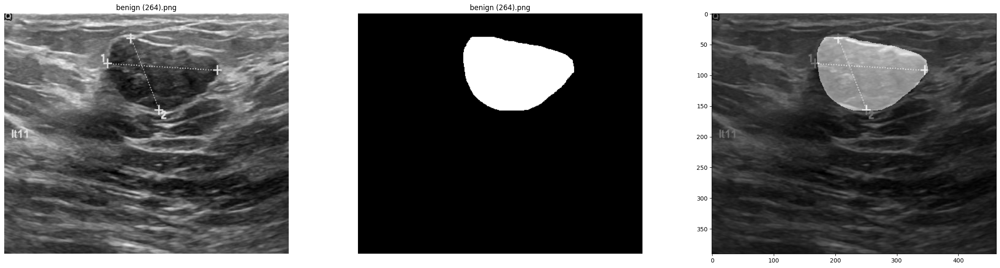

['benign']


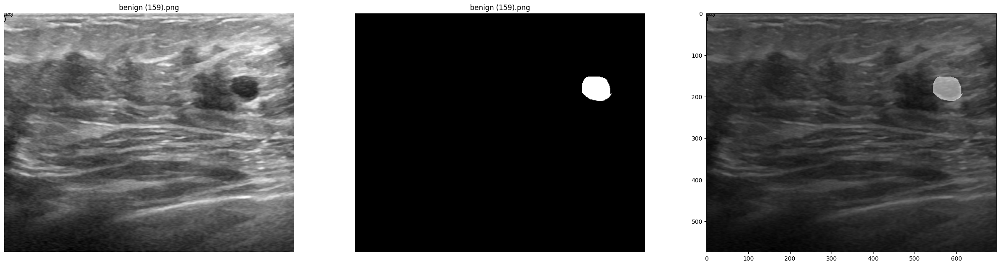

['malignant']


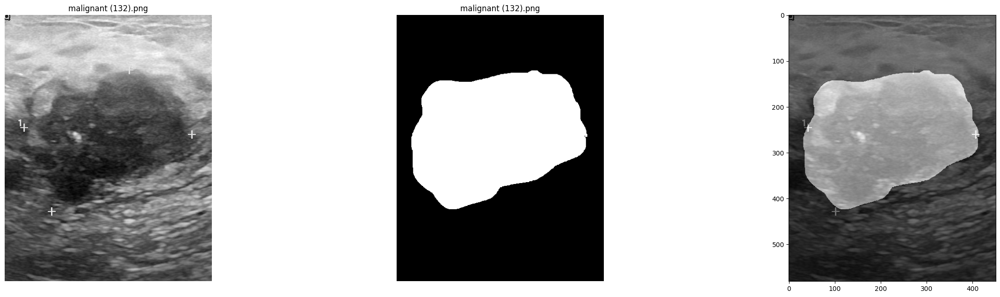

['malignant']


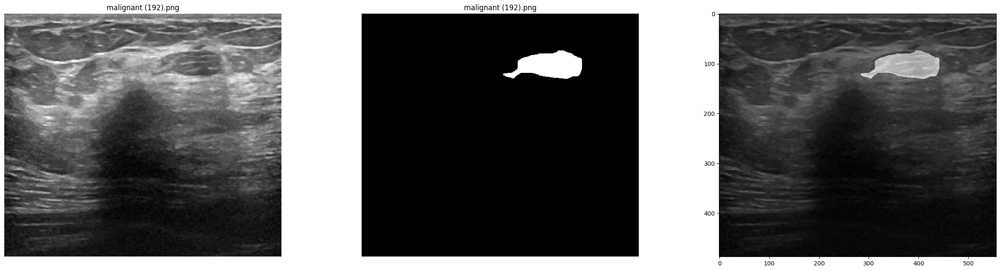

['normal']


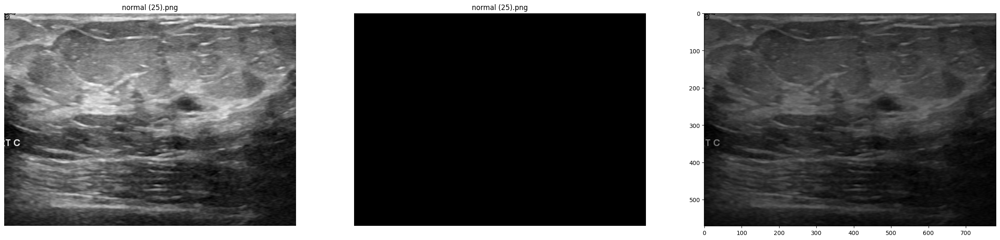

['normal']


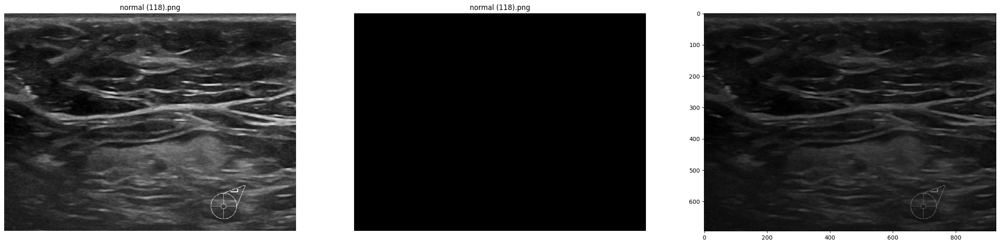

In [ ]:
def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    np.random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [config.BENIGN,config.NORMAL,config.MALIGNANT] if all([i in [config.BENIGN,config.NORMAL,config.MALIGNANT], i in image])])
            cls = [i for i in [config.BENIGN,config.NORMAL,config.MALIGNANT] if all([i in [config.BENIGN,config.NORMAL,config.MALIGNANT], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Convert the mask to a binary image
            msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
            #print(msk_binary.shape)
            ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)
            #print(msk_binary.shape)

            plot3(img, msk, image)

def plot3(img1, img2, title=None):
    fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img1, img2]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(config.BENIGN_DIR, 2)
malignant_images = select_random_images(config.MALIGNANT_DIR, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)

In [ ]:


# Create lists to store the data
categories = []
num_images = []
num_masks = []
smallest_size_x = []
smallest_size_y = []

# Loop through the categories
for i in [config.BENIGN, config.MALIGNANT, config.NORMAL]:
    path_list = os.listdir(os.path.join(config.DATA_DIR, i))
    non_mask = len([j for j in path_list if 'mask' not in j])
    mask = len([j for j in path_list if 'mask' in j])

    categories.append(i)
    num_images.append(non_mask)
    num_masks.append(mask)

    sizes_x = [cv2.imread(os.path.join(config.DATA_DIR, i, j)).shape[0] for j in path_list if 'mask' not in j]
    sizes_y = [cv2.imread(os.path.join(config.DATA_DIR, i, j)).shape[1] for j in path_list if 'mask' not in j]

    smallest_size_x.append(min(sizes_x))
    smallest_size_y.append(min(sizes_y))

# Create a DataFrame
df = pd.DataFrame({
    'Category': categories,
    'Number of Images': num_images,
    'Number of Masks': num_masks,
    'Smallest Size X': smallest_size_x,
    'Smallest Size Y': smallest_size_y
})

# Display the DataFrame
df


,Category,Number of Images,Number of Masks,Smallest Size X,Smallest Size Y
0,benign,437,454,324,315
1,malignant,210,211,332,190
2,normal,133,133,310,391


<Axes: >

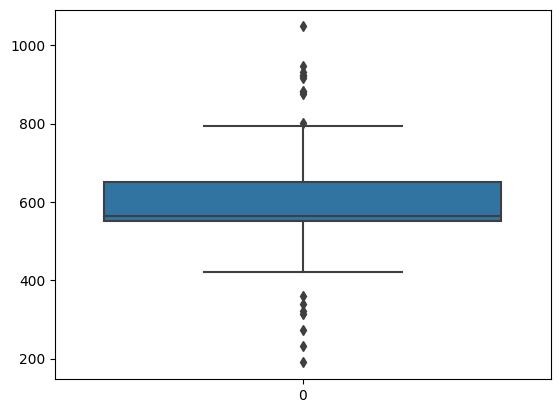

In [ ]:
path_list = os.listdir(os.path.join(config.DATA_DIR, config.MALIGNANT))
sizes_y = [cv2.imread(os.path.join(config.DATA_DIR, config.MALIGNANT, j)).shape[1] for j in path_list if 'mask' not in j]
sns.boxplot(sizes_y)

In [ ]:
def load_image(path, size):
    image = cv2.imread(path)
    image = cv2.resize(image, (size,size))
    if config.DEPTH==1:
      image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image = image/255.
    return image

def load_data(path, size, state):
    images = []
    masks  = []

    imagesmask_path = os.listdir(os.path.join(config.DATA_DIR,state))
    images_path = [i for i in imagesmask_path if 'mask' not in i]
    mask_path   = [i for i in imagesmask_path if 'mask' in i]
    #print(images_path,mask_path)
    for path in images_path:
        #print(path)
        file = os.path.basename(path).replace('.png','')
        #print(file)
        mfiles=[]
        for mfile in mask_path:
            if file in mfile:
                mfiles.append(mfile)
        #if '100' in file:print(mfiles)
        if len(mfiles)==0:
            print(mfiles)
            continue
        elif len(mfiles)==1:
            images.append(load_image(os.path.join(config.DATA_DIR,state,path), size))
            masks.append(load_image(os.path.join(config.DATA_DIR,state,mfiles[0]), size))
            #if '248' in file:print(load_image(os.path.join(config.DATA_DIR,state,mfiles[0]), size)[150])
        elif len(mfiles)>1:
            img = 0
            for mfile in mfiles:
                img += load_image(os.path.join(config.DATA_DIR,state,mfile), size)
                #if '25' in file:print(img[60],'--'*10)
                #img+=img
                #if '100' in file:print('summed',img[60],'--'*10)

                #print(mfile)
            #if '25' in file:print(img[60]/len(mfiles))
            img = np.array(img>0.5, dtype='float64')
            images.append(load_image(os.path.join(config.DATA_DIR,state,path), size))
            #masks.append(img/len(mfiles))
            masks.append(np.array(img>0.5, dtype='float64'))
            #print()

    return np.array(images,dtype=np.float32), np.array(masks,dtype=np.float32)

x_benign, y_benign = load_data(config.DATA_DIR, config.SIZE, config.BENIGN)
x_malignant, y_malignant = load_data(config.DATA_DIR, config.SIZE, config.MALIGNANT)
x_normal, y_normal = load_data(config.DATA_DIR, config.SIZE, config.NORMAL)

In [ ]:
y_benign_label    = np.array([[0,1,0] for i in range(len(y_benign))])
y_malignant_label = np.array([[0,0,1] for i in range(len(y_malignant))])
y_normal_label    = np.array([[1,0,0] for i in range(len(y_normal))])

In [ ]:
x_benign.shape
y_benign_label.shape
y_benign.shape

(437, 256, 256)

(437, 3)

(437, 256, 256)

In [ ]:
ny = len(y_benign_label) + len(y_malignant_label) + len(y_normal_label)
n_classes = 3
class_weight = {0: ny/(n_classes*len(y_normal_label)),
                1: ny/(n_classes*len(y_benign_label)),
                2: ny/(n_classes*len(y_malignant_label))}

In [ ]:
class_weight

{0: 1.9548872180451127, 1: 0.5949656750572082, 2: 1.2380952380952381}

In [ ]:
if config.DEPTH==1:
  # prepare data to modeling
  x_benign = np.expand_dims(x_benign, -1)
  y_benign = np.expand_dims(y_benign, -1)

  # prepare data to modeling
  x_malignant = np.expand_dims(x_malignant, -1)
  y_malignant = np.expand_dims(y_malignant, -1)

  # prepare data to modeling
  x_normal = np.expand_dims(x_normal, -1)
  y_normal = np.expand_dims(y_normal, -1)

In [ ]:
x_total_label = np.concatenate((x_benign, x_malignant, x_normal), axis=0)
y_total_label = np.concatenate((y_benign_label, y_malignant_label, y_normal_label), axis=0)
random_state = 24
y_total_label = np.expand_dims(y_total_label, -1)

X_train_total_label, X_test_total_label, y_train_total_label, y_test_total_label = train_test_split(
                                                                                   x_total_label,
                                                                                   y_total_label,
                                                                                   test_size=config.TEST_SIZE,
                                                                                   shuffle=config.SHUFFLE,
                                                                                   random_state=config.SEED)


#y_malignant = np.expand_dims(y_malignant, -1)
y_train_total_label = np.reshape(y_train_total_label,(-1,3))
y_test_total_label = np.reshape(y_test_total_label,(-1,3))

In [ ]:
x_total = np.concatenate((x_benign,x_malignant), axis=0)
y_total = np.concatenate((y_benign,y_malignant), axis=0)

X_train_total, X_test_total, y_train_total, y_test_total = train_test_split(x_total,
                                                                            y_total,
                                                                            test_size=config.TEST_SIZE,
                                                                            shuffle=config.SHUFFLE,
                                                                            random_state=config.SEED)

In [ ]:
ds_train = tf.data.Dataset.from_tensor_slices((X_train_total, y_train_total))
ds_test = tf.data.Dataset.from_tensor_slices((X_test_total, y_test_total))

In [ ]:
ds_train_label = tf.data.Dataset.from_tensor_slices((X_train_total_label, y_train_total_label))
ds_test_label  = tf.data.Dataset.from_tensor_slices((X_test_total_label, y_test_total_label))

In [ ]:
def prepare_dataset(x,y,batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.batch(batch_size).cache().prefetch(buffer_size=config.AUTOTUNE)
    return dataset

dataset_train = prepare_dataset(X_train_total, y_train_total, config.BATCH_SIZE)
#dataset_val = prepare_dataset(val_df_scaled,62)
dataset_test = prepare_dataset(X_test_total,y_test_total,1)

dataset_train_label = prepare_dataset(X_train_total_label, y_train_total_label, config.BATCH_SIZE)
#dataset_val = prepare_dataset(val_df_scaled,62)
dataset_test_label = prepare_dataset(X_test_total_label,y_test_total_label,1)



In [ ]:
dataset_test
dataset_test_label
y_train_total_label.shape
y_train_total.shape

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None))>

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.int64, name=None))>

(624, 3)

(517, 256, 256, 1)

In [ ]:
tf.keras.backend.clear_session()

In [ ]:
sample_image = X_train_total[0]

def plot_augmentations(augmentation_layer: tf.keras.layers.Layer) -> None:
    augment_name = augmentation_layer.name
    fig, (ax0, *axes) = plt.subplots(ncols=4, figsize=(15, 4))
    ax0.imshow(sample_image)
    ax0.set_title("Original", size=14, pad=10)
    ax0.axis("off")
    for idx, ax in enumerate(axes):
        augmented_image = augmentation_layer(sample_image)
        ax.imshow(augmented_image)
        ax.set_title(augment_name.title(), size=14, pad=10)
        ax.axis("off")

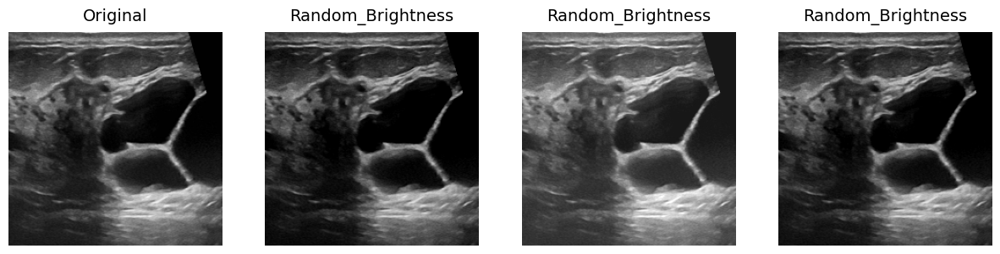

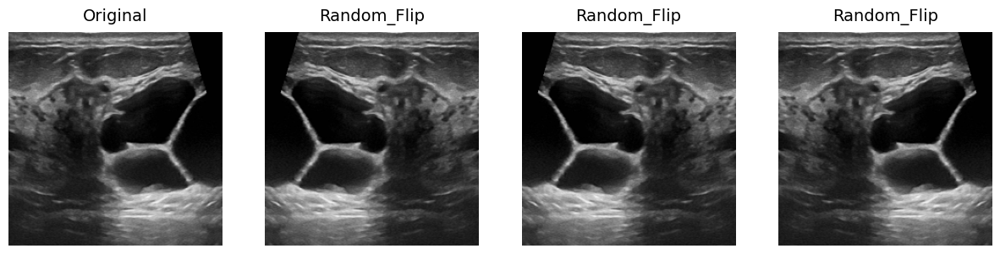

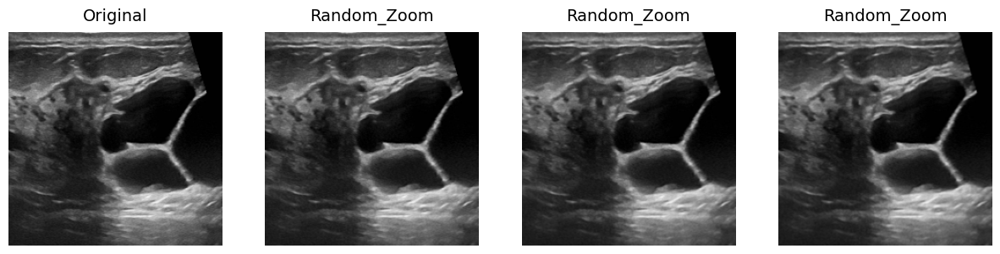

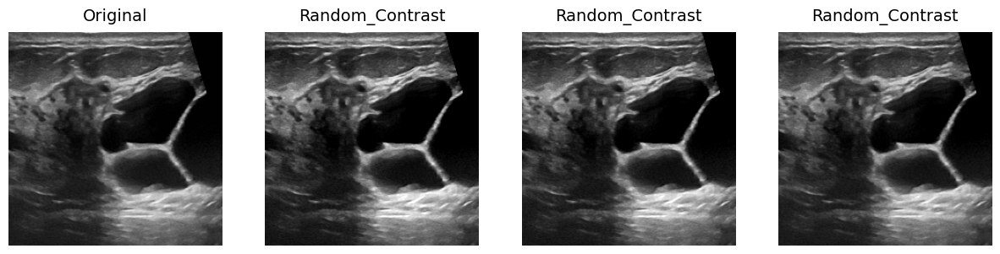

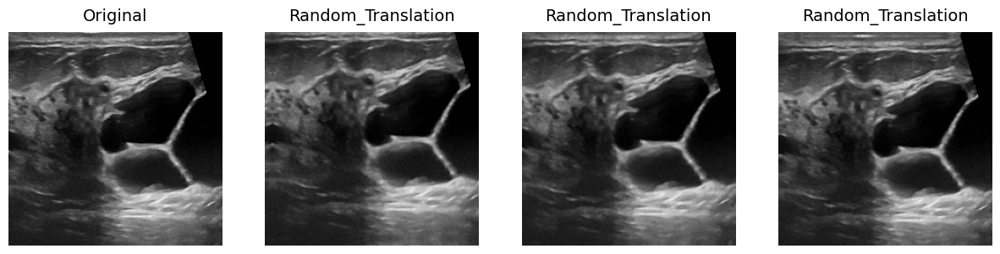

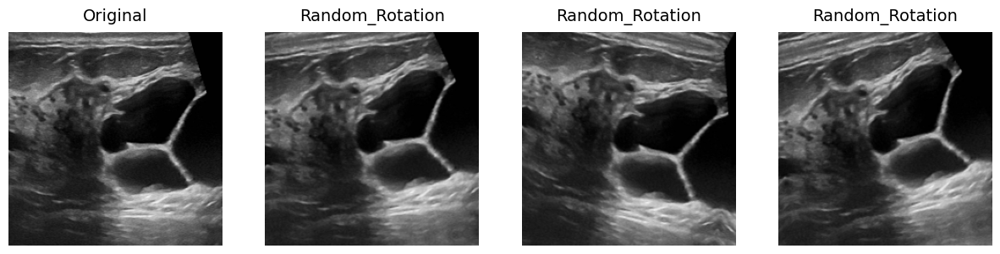

In [ ]:
plot_augmentations(tf.keras.layers.RandomBrightness(0.0004))
plot_augmentations(tf.keras.layers.RandomFlip())
plot_augmentations(tf.keras.layers.RandomZoom(0.01))
plot_augmentations(tf.keras.layers.RandomContrast(0.2))
plot_augmentations(tf.keras.layers.RandomTranslation(height_factor=0.05,width_factor=0.05))
plot_augmentations(tf.keras.layers.RandomRotation(0.05,seed=config.SEED))

In [ ]:
tf.keras.backend.clear_session()
tf.keras.saving.get_custom_objects().clear()


@tf.keras.saving.register_keras_serializable()
def augmentation_layer(x):

    x = tf.keras.layers.RandomFlip(input_shape=(config.HEIGHT,
                                                config.WIDTH,
                                                config.DEPTH),
                                  seed=config.SEED,
                                  name='random_flip')(x)
    x = tf.keras.layers.RandomBrightness(0.0004,
                                         seed=config.SEED,
                                         name='random_brightness')(x)
    x = tf.keras.layers.RandomZoom(0.01,
                                   seed=config.SEED,
                                   name='random_zoom')(x)
    x = tf.keras.layers.RandomContrast(0.2,
                                       seed=config.SEED,
                                       name='random_contrast')(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,
                                          width_factor=0.05,
                                          seed=config.SEED,
                                          name='random_translation')(x)
    x = tf.keras.layers.RandomRotation(0.05,
                                       seed=config.SEED,
                                       name='random_rotation')(x)
    return x

#convolutional block
@tf.keras.saving.register_keras_serializable()
def conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'1')(x)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'1BN')(conv)
    conv = layers.Activation("relu",name=name+'1BNact')(conv)
    if dropout > 0:
        conv = layers.Dropout(dropout)(conv)
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'2')(conv)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'2BN')(conv)
    conv = layers.Activation("relu",name=name+'2BNact')(conv)
    return conv


#residual convolutional block
@tf.keras.saving.register_keras_serializable()
def res_conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv1 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same', name=name+'1')(x)
    if batchnorm is True:
        conv1 = layers.BatchNormalization(axis=3,name=name+'1BN')(conv1)
    conv1 = layers.Activation('relu')(conv1)
    conv2 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same')(conv1)
    if batchnorm is True:
        conv2 = layers.BatchNormalization(axis=3)(conv2)
        conv2 = layers.Activation("relu")(conv2)
    if dropout > 0:
        conv2 = layers.Dropout(dropout)(conv2)

    #skip connection
    shortcut = layers.Conv2D(filters, kernel_size=(1, 1), kernel_initializer='he_normal', padding='same')(x)
    if batchnorm is True:
        shortcut = layers.BatchNormalization(axis=3)(shortcut)
    shortcut = layers.Activation("relu")(shortcut)
    respath = layers.add([shortcut, conv2], name=name+'resfinal')
    return respath


#gating signal for attention unit
@tf.keras.saving.register_keras_serializable()
def gatingsignal(input, out_size, batchnorm=False, name='gate'):
    x = layers.Conv2D(out_size, (1, 1), padding='same')(input)
    if batchnorm:
        x = layers.BatchNormalization()(x)
    x = layers.Activation('relu',name=name+'_act')(x)
    return x

#attention unit/block based on soft attention
@tf.keras.saving.register_keras_serializable()
def attention_block(x, gating, inter_shape, name):
    shape_x = K.int_shape(x)
    shape_g = K.int_shape(gating)
    theta_x = layers.Conv2D(inter_shape, (2, 2), strides=(2, 2),
                            kernel_initializer='he_normal', padding='same')(x)
    shape_theta_x = K.int_shape(theta_x)
    phi_g = layers.Conv2D(inter_shape, (1, 1), kernel_initializer='he_normal', padding='same')(gating)
    upsample_g = layers.Conv2DTranspose(inter_shape, (3, 3), strides=(shape_theta_x[1] // shape_g[1], shape_theta_x[2] // shape_g[2]), kernel_initializer='he_normal', padding='same')(phi_g)
    concat_xg = layers.add([upsample_g, theta_x])
    act_xg = layers.Activation('relu')(concat_xg)
    psi = layers.Conv2D(1, (1, 1), kernel_initializer='he_normal', padding='same')(act_xg)
    sigmoid_xg = layers.Activation('sigmoid')(psi)
    shape_sigmoid = K.int_shape(sigmoid_xg)
    upsample_psi = layers.UpSampling2D(size=(shape_x[1] // shape_sigmoid[1], shape_x[2] // shape_sigmoid[2]))(sigmoid_xg)
    upsample_psi = layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3), arguments={'repnum': shape_x[3]})(upsample_psi)
    y = layers.multiply([upsample_psi, x])
    result = layers.Conv2D(shape_x[3], (1, 1), kernel_initializer='he_normal', padding='same')(y)
    attenblock = layers.BatchNormalization(name=name+'_wgt')(result)
    return attenblock

#Simple U-NET
@tf.keras.saving.register_keras_serializable()
def unetmodel(input_shape, dropout=0.2, batchnorm=False):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm,name='conv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_5')(dn_5)
    up_5 = layers.concatenate([up_5, dn_4], axis=3, name='ups_5_conv_4')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='ups_conv5')

    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, dn_3], axis=3, name='ups_4_conv_3')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='ups_conv4')

    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, dn_2], axis=3, name='ups_3_conv_2')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='ups_conv3')

    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, dn_1], axis=3, name='ups_2_conv_1')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='ups_conv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3,name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Attention U-NET
def attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='dconv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='dconv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='dconv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='dconv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='dconv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate_5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att_5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3, name='up_5_att_5')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='uconv_5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate_4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att_4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3, name='up_4_att_4')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='uconv_4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate_3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att_3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3, name='up_3_att_3')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='uconv_3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate_2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att_2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3, name='up_2_att_2')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='uconv_2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Residual-Attention UNET (RA-UNET)
def residual_attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = res_conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='conv_1')
    pool1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = res_conv_block(pool1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = res_conv_block(pool2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = res_conv_block(pool3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = res_conv_block(pool4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3)
    up_conv_5 = res_conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='upconv5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3)
    up_conv_4 = res_conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='upconv4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3)
    up_conv_3 = res_conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='upconv3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3)
    up_conv_2 = res_conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='upconv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model


In [ ]:
def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice

#@tf.keras.utils.register_keras_serializable()
#def metric_dice():
#  def dice_coef(y_true, y_pred):
#      smooth = 1.
#      y_true_f = K.flatten(y_true)
#      y_pred_f = K.flatten(y_pred)
#      intersection = K.sum(y_true_f * y_pred_f)
#      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
#      return dice
#  return dice_coef

@tf.keras.utils.register_keras_serializable()
def metric_dice(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return dice

#@tf.keras.utils.register_keras_serializable()
#def metric_meanIoU(thres=0.4):
#  def metric(y_true,y_pred):
#    y_pred = tf.cast((y_pred > 0.4),tf.float32)
#    y_true_f = K.flatten(y_true)
#    y_pred_f = K.flatten(y_pred)
#    smooth=0
#    intersection = K.sum(y_true_f * y_pred_f)
#    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
#    mean_iou = K.mean((intersection + smooth) / (union + smooth))
#    return mean_iou
#  return metric

@tf.keras.utils.register_keras_serializable()
def metric_meanIoU(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))

    return mean_iou

def recall(y_true, y_pred, c):
    y_true = K.flatten(y_true)
    pred_c = K.cast(K.equal(K.argmax(y_pred, axis=-1), c), K.floatx())
    true_c = K.cast(K.equal(y_true, c), K.floatx())
    true_positives = K.sum(pred_c * true_c)
    possible_postives = K.sum(true_c)
    return true_positives / (possible_postives + K.epsilon())


def precision(y_true, y_pred, c):
    y_true = K.flatten(y_true)
    pred_c = K.cast(K.equal(K.argmax(y_pred, axis=-1), c), K.floatx())
    true_c = K.cast(K.equal(y_true, c), K.floatx())
    true_positives = K.sum(pred_c * true_c)
    pred_positives = K.sum(pred_c)
    return true_positives / (pred_positives + K.epsilon())

def recall_c0(y_true, y_pred):
    return recall(y_true, y_pred, 0)

def precision_c0(y_true, y_pred):
    return precision(y_true, y_pred, 0)

def recall_c1(y_true, y_pred):
    return recall(y_true, y_pred, 1)

def precision_c1(y_true, y_pred):
    return precision(y_true, y_pred, 1)

def recall_c2(y_true, y_pred):
    return recall(y_true, y_pred, 2)

def precision_c2(y_true, y_pred):
    return precision(y_true, y_pred, 2)

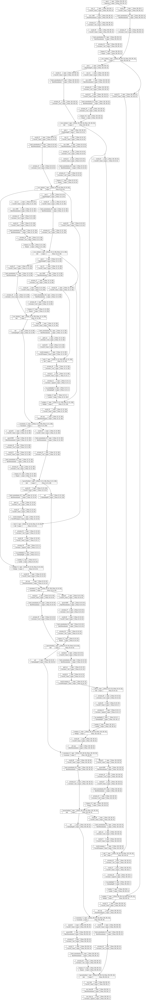

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv_11 (Conv2D)            (None, 256, 256, 16)         160       ['input_2[0][0]']             
                                                                                                  
 conv_11BN (BatchNormalizat  (None, 256, 256, 16)         64        ['conv_11[0][0]']             
 ion)                                                                                             
                                                                                                  
 activation_35 (Activation)  (None, 256, 256, 16)         0         ['conv_11BN[0][0]']     

In [ ]:
#tf.keras.backend.clear_session()

model = residual_attentionunet(input_shape=(256,256,1))

#model = attentionunet(input_shape=(256,256,1))
#model = unetmodel(input_shape=(256,256,1))
#runet_model = residual_attentionunet(input_shape=(256,256,1))


#model = VGG_model

tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)
model.summary()

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=config.LR),
              #loss=dice_coef_loss,
              loss=tf.keras.losses.BinaryCrossentropy(),
              #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
              metrics = [metric_meanIoU,metric_dice])

In [ ]:
METRICS = [
      #tf.keras.metrics.BinaryCrossentropy(name='cross entropy'),  # same as model's loss
      #tf.keras.metrics.MeanSquaredError(name='Brier score'),
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'),
      #tf.keras.metrics.Accuracy(name='accuracy'),
      #tf.keras.metrics.Precision(name='precision'),
      #tf.keras.metrics.Recall(name='recall'),
      #tf.keras.metrics.AUC(name='auc'),
      #tf.keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              #loss=dice_coef_loss,
              #loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
              #metrics = [recall_c0,recall_c1,recall_c2]
              )
#binary cross entropy
#NUM_EPCHS=15

In [ ]:
def load_wgt():
  model.load_weights('best_model_resunet.hdf5', skip_mismatch=False, by_name=False, options=None)

load_wgt()

In [ ]:
dataset_train
model.input


<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None))>

<KerasTensor: shape=(None, 224, 224, 3) dtype=float32 (created by layer 'input_1')>

In [ ]:
checkpoint = ModelCheckpoint('best_model_resunet.hdf5' ,
                             monitor = 'val_loss',
                             verbose = 1,
                             save_best_only=True,
                             mode = 'min',
                             save_weights_only=True,
                             save_freq='epoch'
                            )
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.3,
                              patience=15, min_lr=0.00005)

callbacks_list = [checkpoint, reduce_lr]

# Fit model
history = model.fit(dataset_train,
                    validation_data=dataset_test,
                    #steps_per_epoch=len(X_train)/(6),
                    #validation_steps=10,
                    callbacks=callbacks_list,
                    epochs=config.NUM_EPOCHS,
                    class_weight=class_weight
                    #verbose=2,
                    )

Epoch 1/15
33/33 [==============================] - ETA: 0s - loss: 0.3310 - metric_meanIoU: 0.7288 - metric_dice: 0.4691
Epoch 1: val_loss improved from inf to 0.28215, saving model to best_model_resunet.hdf5
33/33 [==============================] - 39s 459ms/step - loss: 0.3310 - metric_meanIoU: 0.7288 - metric_dice: 0.4691 - val_loss: 0.2822 - val_metric_meanIoU: 0.4656 - val_metric_dice: 0.3024 - lr: 0.0010


KeyboardInterrupt: ignored

In [ ]:
for i,j in dataset_train_label:
  print(i.shape,i,j)
  break
dataset_train_label

(16, 256, 256, 3) tf.Tensor(
[[[[ 26.  26.  26.]
   [201. 201. 201.]
   [  9.   9.   9.]
   ...
   [128. 128. 128.]
   [  2.   2.   2.]
   [  2.   2.   2.]]

  [[ 27.  27.  27.]
   [202. 202. 202.]
   [ 23.  23.  23.]
   ...
   [152. 152. 152.]
   [ 25.  25.  25.]
   [  5.   5.   5.]]

  [[ 28.  28.  28.]
   [204. 204. 204.]
   [ 30.  30.  30.]
   ...
   [130. 130. 130.]
   [ 92.  92.  92.]
   [  0.   0.   0.]]

  ...

  [[ 20.  20.  20.]
   [ 20.  20.  20.]
   [ 18.  18.  18.]
   ...
   [ 19.  19.  19.]
   [ 18.  18.  18.]
   [ 21.  21.  21.]]

  [[ 20.  20.  20.]
   [ 22.  22.  22.]
   [ 21.  21.  21.]
   ...
   [ 24.  24.  24.]
   [ 22.  22.  22.]
   [ 22.  22.  22.]]

  [[ 19.  19.  19.]
   [ 19.  19.  19.]
   [ 15.  15.  15.]
   ...
   [ 27.  27.  27.]
   [ 29.  29.  29.]
   [ 29.  29.  29.]]]


 [[[117. 117. 117.]
   [127. 127. 127.]
   [  4.   4.   4.]
   ...
   [221. 221. 221.]
   [215. 215. 215.]
   [204. 204. 204.]]

  [[121. 121. 121.]
   [120. 120. 120.]
   [ 39.  39.  39.]

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.int64, name=None))>

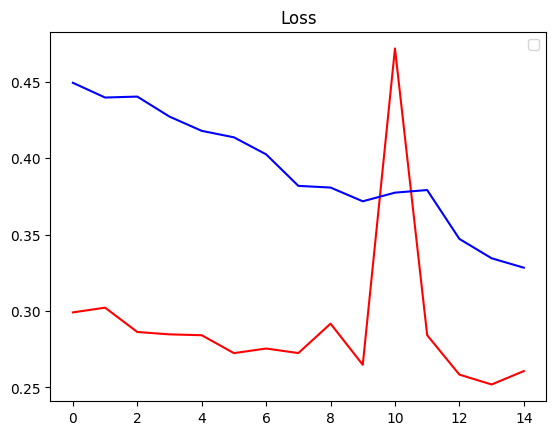

In [ ]:
def plot_loss_history(history):
    # validation losses
    val_loss = history.history['val_loss']
    loss = history.history['loss']

    plt.title('Loss')
    plt.plot(val_loss, 'r', loss, 'b')
    plt.legend()
    plt.show()

plot_loss_history(history)

#unet:    33/33 [==============================] - 7s 214ms/step - loss: 0.4043 - metric: 0.4867 - dice_coef: 0.3052 - val_loss: 0.4089 - val_metric: 0.5332 - val_dice_coef: 0.2121 - lr: 0.0010
#attunet: 33/33 [==============================] - 12s 362ms/step - loss: 0.4014 - metric: 0.4877 - dice_coef: 0.3069 - val_loss: 0.3977 - val_metric: 0.3644 - val_dice_coef: 0.2074 - lr: 0.0010
#reunet:  33/33 [==============================] - 14s 414ms/step - loss: 0.3899 - metric: 0.5212 - dice_coef: 0.3185 - val_loss: 0.4039 - val_metric: 0.4067 - val_dice_coef: 0.2293 - lr: 0.0010
#reunet 3dep:33/33 [==============================] - 11s 319ms/step - loss: 0.7405 - metric: 0.5708 - dice_coef: 0.3330 - val_loss: 0.5401 - val_metric: 0.2450 - val_dice_coef: 0.2397 - lr: 0.0010
#33/33 [==============================] - 14s 414ms/step - loss: 0.3287 - metric: 0.7449 - dice_coef: 0.4762 - val_loss: 0.2628 - val_metric: 0.4661 - val_dice_coef: 0.2909 - lr: 0.0010


#effinet: 39/39 [==============================] - 37s 947ms/step - loss: 0.6167 - val_loss: 1.0856 - lr: 0.001

In [ ]:
y_pred_total = model.predict(dataset_test_label, verbose=1)

156/156 [==============================] - 2s 8ms/step


In [ ]:
model.save('Segmentation_model.keras')

In [ ]:
np.argmax(y_pred_total,axis=1)
y_test_total_label
y_pred_total

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 2, 1, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2,
       2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 1,
       1, 1])

array([[0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 0, 1],
       [0, 1, 0],
       [0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [1, 0, 0],
       [1, 0, 0],
       [1, 0, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0,

array([[0.15433636, 0.79106706, 0.05459654],
       [0.3265916 , 0.37611356, 0.29729486],
       [0.06424157, 0.74761975, 0.18813877],
       [0.2950921 , 0.6519049 , 0.05300295],
       [0.05661095, 0.86344177, 0.07994732],
       [0.14961874, 0.6548916 , 0.19548963],
       [0.04006509, 0.7266401 , 0.23329474],
       [0.20115954, 0.6269599 , 0.17188056],
       [0.08412061, 0.8120553 , 0.10382413],
       [0.08539028, 0.88726324, 0.02734649],
       [0.03650925, 0.70229965, 0.26119107],
       [0.14229658, 0.7170406 , 0.14066279],
       [0.02569895, 0.89693886, 0.0773622 ],
       [0.6325256 , 0.27785295, 0.08962145],
       [0.08679474, 0.41571912, 0.4974861 ],
       [0.04672735, 0.62830704, 0.32496554],
       [0.19470887, 0.6321204 , 0.17317075],
       [0.02481234, 0.8819685 , 0.09321913],
       [0.16084573, 0.5641676 , 0.2749867 ],
       [0.13434942, 0.77237016, 0.0932804 ],
       [0.08655578, 0.465469  , 0.44797522],
       [0.17533271, 0.6284037 , 0.19626355],
       [0.

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)

130/130 [==============================] - 2s 8ms/step


In [ ]:
y_pred_total

array([[[[0.14577174],
         [0.14571884],
         [0.1474157 ],
         ...,
         [0.14656267],
         [0.1453273 ],
         [0.14802805]],

        [[0.14818493],
         [0.14567147],
         [0.14636737],
         ...,
         [0.1471824 ],
         [0.14868523],
         [0.14873104]],

        [[0.14692664],
         [0.14447397],
         [0.14532912],
         ...,
         [0.14543243],
         [0.1474045 ],
         [0.14775176]],

        ...,

        [[0.14256184],
         [0.13826022],
         [0.13993227],
         ...,
         [0.13994227],
         [0.14223883],
         [0.14384939]],

        [[0.143809  ],
         [0.13973188],
         [0.14069705],
         ...,
         [0.139466  ],
         [0.1432592 ],
         [0.14259398]],

        [[0.1439243 ],
         [0.13975954],
         [0.13940777],
         ...,
         [0.13718094],
         [0.13925213],
         [0.14042786]]],


       [[[0.14324848],
         [0.1402102 ],
         [0.14

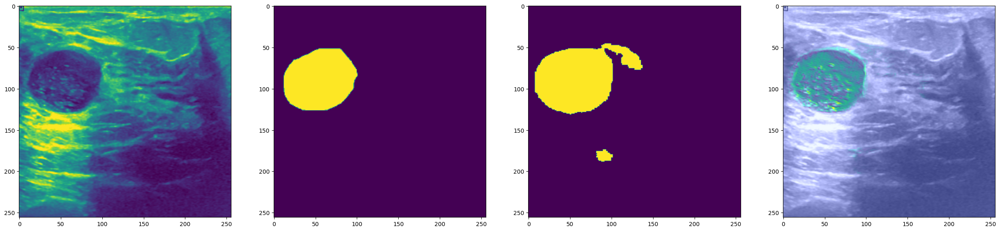

TypeError: ignored

In [ ]:
explainer = GradCAM()
def plotter(images, masks, predicted_images, n):
    for i in range(n):
        fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10, 5))
        plt.subplots_adjust(right=2.5, top=1.25)
        axs[0].imshow(images[i])
        axs[1].imshow(masks[i])
        #axs[2].imshow(predicted_images[i])
        axs[2].imshow(predicted_images[i] > 0.4 )
        axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2_wgt',class_index=1),cmap='gray')
        #axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'conv_final_op',class_index=3),cmap='gray')

        #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
        #.astype(int)
        plt.show()
        fig.savefig(f'{i}_total.png')


plotter(X_test_total,y_test_total,y_pred_total,20)
#plotter(X_train_total,y_train_total,y_pred_total,20)

In [ ]:
pretrained_efficientnet_base = tf.keras.applications.efficientnet_v2.EfficientNetV2B1(
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3),
    weights="imagenet",
    pooling="avg",
)
pretrained_efficientnet_base.trainable = False

efficientnet_model = tf.keras.Sequential([
    layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3)),
    # Data augmentation
    layers.RandomBrightness(0.2, seed=SEED),
    layers.RandomFlip(seed=SEED),
    layers.RandomRotation(0.2, seed=SEED),
    # EfficientNet
    pretrained_efficientnet_base,
    layers.Dropout(0.4),
    # Fully connected layers
    layers.Dense(256, activation="relu"),
    layers.Dropout(0.3),
    layers.Dense(32, activation="relu"),
    layers.Dropout(0.2),
    layers.Dense(1, activation="sigmoid")
], name="EfficientNetB1")
efficientnet_model.summary()

model =

In [ ]:
tf.keras.backend.clear_session()

def augmentation_layer(x):
    x = tf.keras.layers.RandomFlip(input_shape=(
                                  config.HEIGHT,
                                  config.WIDTH,
                                  config.DEPTH) seed=config.SEED)(x)
    x = tf.keras.layers.RandomBrightness(0.0004,seed=config.SEED)(x)
    x = tf.keras.layers.RandomZoom(0.01,seed=config.SEED)(x)
    x = tf.keras.layers.RandomContrast(0.2,seed=config.SEED)(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,width_factor=0.05,seed=config.SEED)(x)
    x = tf.keras.layers.RandomRotation(0.05,seed=config.SEED)(x)

    return x

def double_conv_block(x, n_filters):

   # Conv2D then ReLU activation
   x = tf.keras.layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
   # Conv2D then ReLU activation
   x = tf.keras.layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)

   return x

def downsample_block(x, n_filters):
   f = double_conv_block(x, n_filters)
   p = tf.keras.layers.MaxPool2D(2)(f)
   p = tf.keras.layers.Dropout(0.3)(p)

   return f, p

def upsample_block(x, conv_features, n_filters):
   # upsample
   x = tf.keras.layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
   # concatenate
   x = tf.keras.layers.concatenate([x, conv_features])
   # dropout
   x = tf.keras.layers.Dropout(0.3)(x)
   # Conv2D twice with ReLU activation
   x = double_conv_block(x, n_filters)

   return x

def build_unet_model():
     # inputs
   inputs = tf.keras.layers.Input(shape=(256,256,1))

   #aug_inputs = augmentation_layer(inputs)

   # encoder: contracting path - downsample
   # 1 - downsample
   f1, p1 = downsample_block(inputs, 64)
   # 2 - downsample
   f2, p2 = downsample_block(p1, 128)
   # 3 - downsample
   f3, p3 = downsample_block(p2, 256)
   # 4 - downsample
   f4, p4 = downsample_block(p3, 512)

   # 5 - bottleneck
   bottleneck = double_conv_block(p4, 1024)

   # decoder: expanding path - upsample
   # 6 - upsample
   u6 = upsample_block(bottleneck, f4, 512)
   # 7 - upsample
   u7 = upsample_block(u6, f3, 256)
   # 8 - upsample
   u8 = upsample_block(u7, f2, 128)
   # 9 - upsample
   u9 = upsample_block(u8, f1, 64)

   # outputs
   outputs = tf.keras.layers.Conv2D(1, (1,1), padding="same", activation = "sigmoid")(u9)

   # unet model with Keras Functional API
   unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

   return unet_model

model = build_unet_model()
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)
model.summary()

SyntaxError: ignored

In [ ]:
# Custom loss function
def metric_dice():
  def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice
  return dice_coef

def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

def metric_meaniou(thres=0.4):
  def metric(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))
    return mean_iou
  return metric

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LR),
                   #loss=dice_coef_loss,
                   loss=tf.keras.losses.BinaryCrossentropy(),
                   #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
                   metrics = [metric_meaniou(),metric_dice()])
#binary cross entropy
NUM_EPOCHS=15

In [ ]:
import numpy
# learning rate
LR = 0.001
# Custom loss function
def metric_dice():
  def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice
  return dice_coef

def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

# Custom IoU metric
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3]) + K.sum(y_pred,[1,2,3]) - intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

def metric_meaniou(thres=0.4):
  def metric(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))
    #print(f'metric_meaniou: {mean_iou.numpy()}')  # Print the value
    return mean_iou
    #return tf.keras.metrics.sparse_categorical_accuracy(yTrue, yPred)
  return metric

class Meaniou(tf.keras.metrics.Metric):

  def __init__(self, name='mean_iou', **kwargs):
    super().__init__(name=name, **kwargs)
    self.mean_iou = 0

  def update_state(self, y_true, y_pred, sample_weight=None):
    #y_true = tf.cast(y_true, tf.bool)
    #y_pred = tf.cast(y_pred, tf.bool)
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    #print(y_pred)
    #print(y_true)
    smooth=0
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    self.mean_iou = K.mean((intersection + smooth) / (union + smooth))
    print(f'metric_meaniou in custom: {self.mean_iou.numpy()}')  # Print the value
    #print(self.mean_iou)

  def result(self):
    return self.mean_iou

  def reset_state(self):
    self.mean_iou+=self.mean_iou


model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LR),
                   #loss=dice_coef_loss,
                   loss=tf.keras.losses.BinaryCrossentropy(),
                   #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
                   metrics = [metric_meaniou(),metric_dice()])
                   #run_eagerly=True)
#binary cross entropy
NUM_EPOCHS=15


In [ ]:
model.load_weights('best_model.hdf5', skip_mismatch=False, by_name=False, options=None)

In [ ]:


checkpoint = ModelCheckpoint('best_model.hdf5' ,
                             monitor = 'val_loss',
                             verbose = 1,
                             save_best_only=True,
                             mode = 'min',
                             save_weights_only=True,
                             save_freq='epoch'
                            )
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.3,
                              patience=15, min_lr=0.00005)

callbacks_list = [checkpoint, reduce_lr]

# Fit model
history = model.fit(dataset_train,
                    validation_data=dataset_test,
                    #steps_per_epoch=len(X_train)/(6),
                    #validation_steps=10,
                    callbacks=callbacks_list,
                    epochs=NUM_EPOCHS,
                    #verbose=2,
                    )

Epoch 1/15
29/29 [==============================] - ETA: 0s - loss: 0.2782 - metric: 0.6650 - dice_coef: 0.3952
Epoch 1: val_loss improved from inf to 0.32211, saving model to best_model.hdf5
29/29 [==============================] - 11s 375ms/step - loss: 0.2782 - metric: 0.6650 - dice_coef: 0.3952 - val_loss: 0.3221 - val_metric: 0.4524 - val_dice_coef: 0.2590 - lr: 0.0010
Epoch 2/15
29/29 [==============================] - ETA: 0s - loss: 0.2705 - metric: 0.6715 - dice_coef: 0.4044
Epoch 2: val_loss improved from 0.32211 to 0.31114, saving model to best_model.hdf5
29/29 [==============================] - 11s 379ms/step - loss: 0.2705 - metric: 0.6715 - dice_coef: 0.4044 - val_loss: 0.3111 - val_metric: 0.5281 - val_dice_coef: 0.2641 - lr: 0.0010
Epoch 3/15
29/29 [==============================] - ETA: 0s - loss: 0.2624 - metric: 0.6828 - dice_coef: 0.4124
Epoch 3: val_loss did not improve from 0.31114
29/29 [==============================] - 11s 372ms/step - loss: 0.2624 - metric: 0.

In [ ]:

#pip install tf-explain
from tf_explain.core.grad_cam import GradCAM


In [ ]:
X_test_total[0].shape
model.get_layer('conv2d_18')

(256, 256, 1)

In [ ]:
explainer = GradCAM()
explainer.explain((np.expand_dims(X_test_total[0], 0),y_test_total[0]), model, layer_name = 'conv2d_18',class_index=1).shape

(256, 256, 3)

In [ ]:
unet_model.save_weights('weights', overwrite=True, save_format=None, options=None)

In [ ]:
unet_model.load_weights('best_model.hdf5', skip_mismatch=False, by_name=False, options=None)


ValueError: ignored

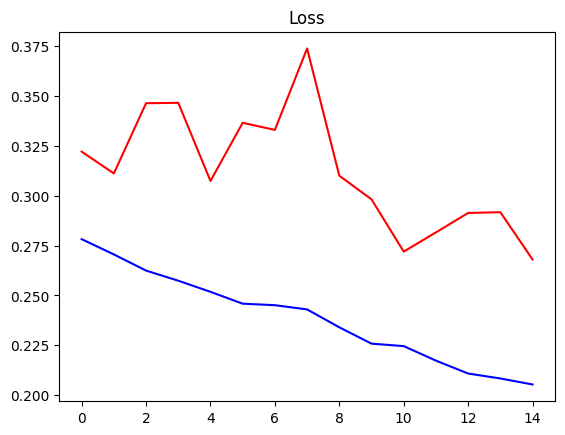

In [ ]:
def plot_loss_history(history):
    # validation losses
    val_loss = history.history['val_loss']
    loss = history.history['loss']

    plt.title('Loss')
    plt.plot(val_loss, 'r', loss, 'b')
    plt.show()

plot_loss_history(history)

In [ ]:
y_pred_total[0].shape

(256, 256, 1)

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)

195/195 [==============================] - 1s 8ms/step


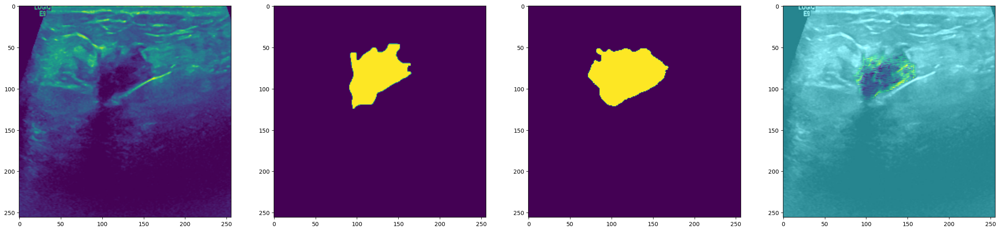

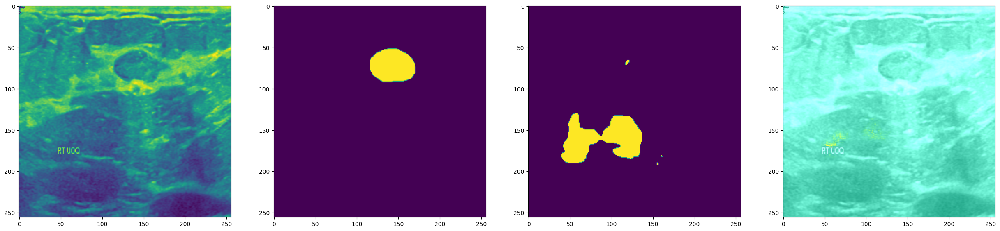

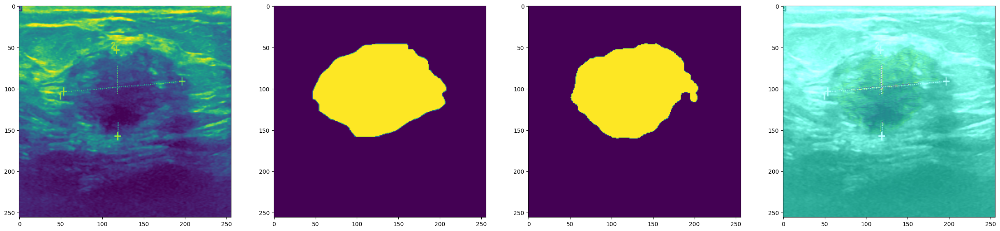

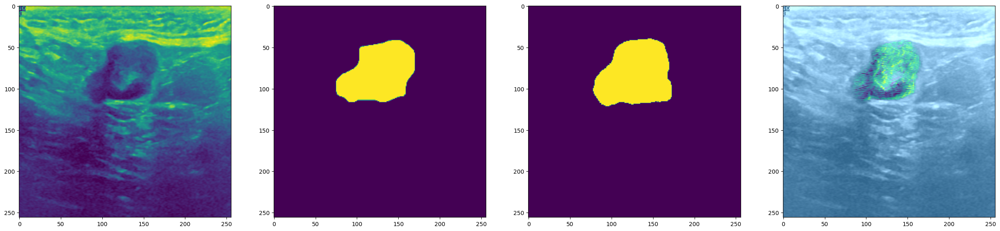

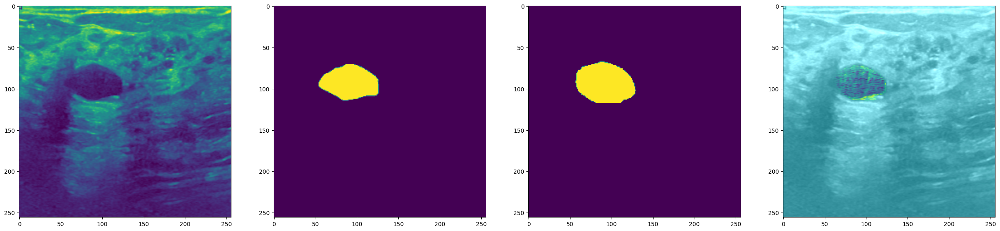

...

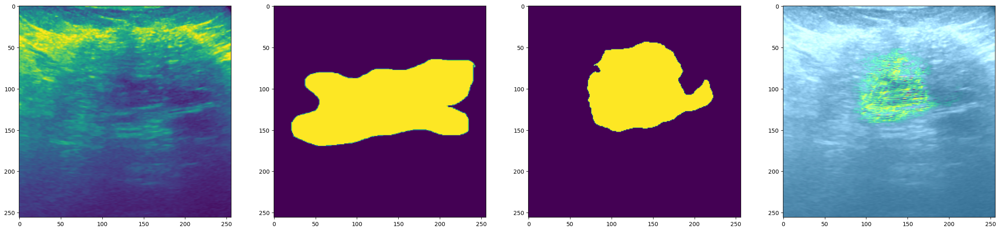

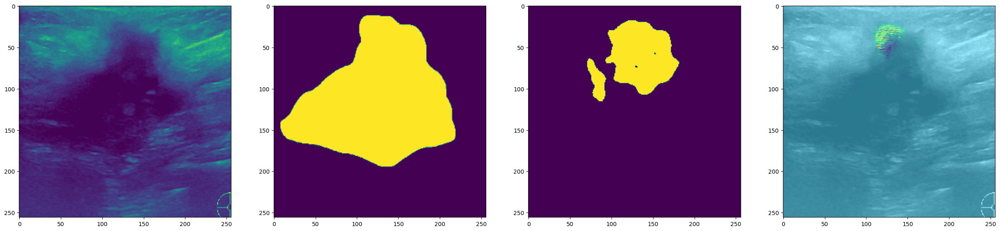

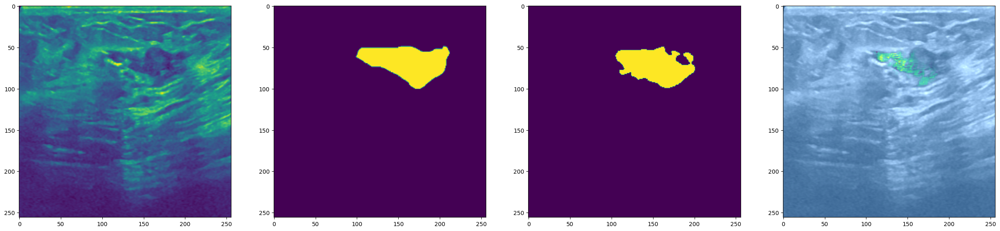

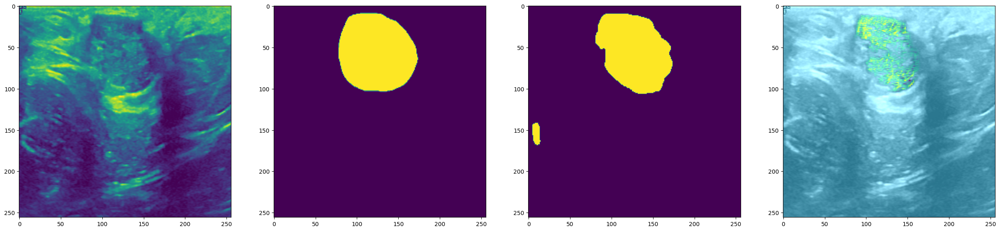

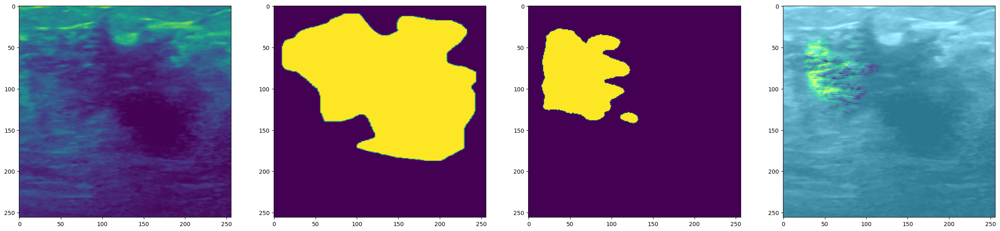

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)
def plotter(images, masks, predicted_images, n):
    for i in range(n):
        fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10, 5))
        plt.subplots_adjust(right=2.5, top=1.25)
        axs[0].imshow(images[i])
        axs[1].imshow(masks[i])
        #axs[2].imshow(predicted_images[i])
        axs[2].imshow(predicted_images[i] > 0.4)
        axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2',class_index=1),cmap='gray')
        #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
        #.astype(int)
        plt.show()


plotter(X_test_total,y_test_total,y_pred_total,20)
#plotter(X_train_total,y_train_total,y_pred_total,20)

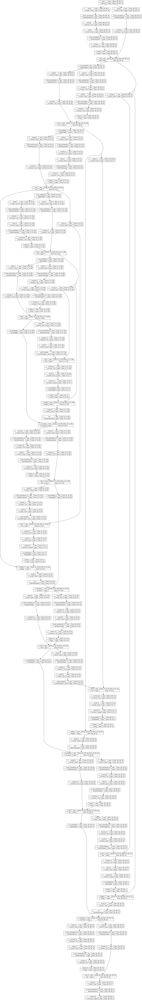

In [ ]:
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)

In [ ]:
tf.keras.backend.clear_session()

def augmentation_layer(x):
    x = tf.keras.layers.RandomFlip(input_shape=(config.HEIGHT,
                                                config.WIDTH,
                                                config.DEPTH),
                                  seed=config.SEED,
                                  name='random_flip')(x)
    x = tf.keras.layers.RandomBrightness(0.0004,
                                         seed=config.SEED,
                                         name='random_brightness')(x)
    x = tf.keras.layers.RandomZoom(0.01,
                                   seed=config.SEED,
                                   name='random_zoom')(x)
    x = tf.keras.layers.RandomContrast(0.2,
                                       seed=config.SEED,
                                       name='random_contrast')(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,
                                          width_factor=0.05,
                                          seed=config.SEED,
                                          name='random_translation')(x)
    x = tf.keras.layers.RandomRotation(0.05,
                                       seed=config.SEED,
                                       name='random_rotation')(x)
    return x

#convolutional block
def conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'1')(x)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'1BN')(conv)
    conv = layers.Activation("relu",name=name+'1BNact')(conv)
    if dropout > 0:
        conv = layers.Dropout(dropout)(conv)
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'2')(conv)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'2BN')(conv)
    conv = layers.Activation("relu",name=name+'2BNact')(conv)
    return conv


#residual convolutional block
def res_conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv1 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same', name=name+'1')(x)
    if batchnorm is True:
        conv1 = layers.BatchNormalization(axis=3,name=name+'1BN')(conv1)
    conv1 = layers.Activation('relu')(conv1)
    conv2 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same')(conv1)
    if batchnorm is True:
        conv2 = layers.BatchNormalization(axis=3)(conv2)
        conv2 = layers.Activation("relu")(conv2)
    if dropout > 0:
        conv2 = layers.Dropout(dropout)(conv2)

    #skip connection
    shortcut = layers.Conv2D(filters, kernel_size=(1, 1), kernel_initializer='he_normal', padding='same')(x)
    if batchnorm is True:
        shortcut = layers.BatchNormalization(axis=3)(shortcut)
    shortcut = layers.Activation("relu")(shortcut)
    respath = layers.add([shortcut, conv2], name=name+'resfinal')
    return respath


#gating signal for attention unit
def gatingsignal(input, out_size, batchnorm=False, name='gate'):
    x = layers.Conv2D(out_size, (1, 1), padding='same')(input)
    if batchnorm:
        x = layers.BatchNormalization()(x)
    x = layers.Activation('relu',name=name+'_act')(x)
    return x

#attention unit/block based on soft attention
def attention_block(x, gating, inter_shape, name):
    shape_x = K.int_shape(x)
    shape_g = K.int_shape(gating)
    theta_x = layers.Conv2D(inter_shape, (2, 2), strides=(2, 2),
                            kernel_initializer='he_normal', padding='same')(x)
    shape_theta_x = K.int_shape(theta_x)
    phi_g = layers.Conv2D(inter_shape, (1, 1), kernel_initializer='he_normal', padding='same')(gating)
    upsample_g = layers.Conv2DTranspose(inter_shape, (3, 3), strides=(shape_theta_x[1] // shape_g[1], shape_theta_x[2] // shape_g[2]), kernel_initializer='he_normal', padding='same')(phi_g)
    concat_xg = layers.add([upsample_g, theta_x])
    act_xg = layers.Activation('relu')(concat_xg)
    psi = layers.Conv2D(1, (1, 1), kernel_initializer='he_normal', padding='same')(act_xg)
    sigmoid_xg = layers.Activation('sigmoid')(psi)
    shape_sigmoid = K.int_shape(sigmoid_xg)
    upsample_psi = layers.UpSampling2D(size=(shape_x[1] // shape_sigmoid[1], shape_x[2] // shape_sigmoid[2]))(sigmoid_xg)
    upsample_psi = layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3), arguments={'repnum': shape_x[3]})(upsample_psi)
    y = layers.multiply([upsample_psi, x])
    result = layers.Conv2D(shape_x[3], (1, 1), kernel_initializer='he_normal', padding='same')(y)
    attenblock = layers.BatchNormalization(name=name+'_wgt')(result)
    return attenblock

#Simple U-NET
def unetmodel(input_shape, dropout=0.2, batchnorm=False):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm,name='conv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_5')(dn_5)
    up_5 = layers.concatenate([up_5, dn_4], axis=3, name='ups_5_conv_4')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='ups_conv5')

    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, dn_3], axis=3, name='ups_4_conv_3')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='ups_conv4')

    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, dn_2], axis=3, name='ups_3_conv_2')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='ups_conv3')

    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, dn_1], axis=3, name='ups_2_conv_1')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='ups_conv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3,name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Attention U-NET
def attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='dconv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='dconv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='dconv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='dconv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='dconv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate_5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att_5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3, name='up_5_att_5')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='uconv_5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate_4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att_4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3, name='up_4_att_4')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='uconv_4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate_3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att_3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3, name='up_3_att_3')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='uconv_3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate_2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att_2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3, name='up_2_att_2')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='uconv_2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Residual-Attention UNET (RA-UNET)
def residual_attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = res_conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='conv_1')
    pool1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = res_conv_block(pool1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = res_conv_block(pool2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = res_conv_block(pool3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = res_conv_block(pool4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3)
    up_conv_5 = res_conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='upconv5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3)
    up_conv_4 = res_conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='upconv4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3)
    up_conv_3 = res_conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='upconv3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3)
    up_conv_2 = res_conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='upconv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

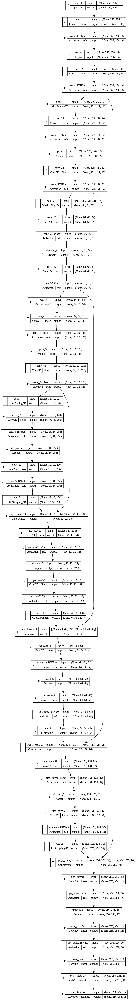

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv_11 (Conv2D)            (None, 256, 256, 16)         160       ['input_1[0][0]']             
                                                                                                  
 conv_11BNact (Activation)   (None, 256, 256, 16)         0         ['conv_11[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 16)         0         ['conv_11BNact[0][0]']        
                                                                                              

In [ ]:
#model = residual_attentionunet(input_shape=(256,256,1))
#model = attentionunet(input_shape=(256,256,1))
model = unetmodel(input_shape=(256,256,1))
#runet_model = residual_attentionunet(input_shape=(256,256,1))
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)
model.summary()

In [ ]:
class Config:
    '''
    Config in which I hold all hyperparameters and frequently used variables such as image shape, train directory path etc.
    '''
    def __init__(self, DEBUG=False):
        self.DEBUG = DEBUG

    TRAIN_CSV = '../input/sartorius-cell-instance-segmentation/train.csv'
    TRAIN_DIR = '../input/sartorius-cell-instance-segmentation/train/'
    TEST_DIR = '../input/sartorius-cell-instance-segmentation/test/'

    IMG_SHAPE = (256, 256)

    LR = 1e-3

    EPOCHS = 100

    N_FILTERS = 32


    #BATCH_SIZE = 4
    AUTOTUNE = tf.data.AUTOTUNE

    N_CLASSES = 1
    #BUFFER_SIZE = 2

    #val_size = 0.1

    #WEIGHTS_PATH = os.path.join('./', 'model.h5')

    seed = 123


config = Config()

In [ ]:
def attention(input_tensor, g, inter_shape):
    input_shapes = input_tensor.shape
    g_shapes = g.shape

    x = tf.keras.layers.Conv2D(inter_shape, 1, 2, padding="same")(input_tensor)
    g = tf.keras.layers.Conv2D(inter_shape, 1, padding="same")(g)


    add = tf.keras.layers.add([x, g])
    relu = tf.keras.layers.Activation('relu')(x)

    psi = tf.keras.layers.Conv2D(1, 1, padding="same")(relu)
    sigmoid = tf.keras.layers.Activation('sigmoid')(psi)

    upsample = tf.keras.layers.UpSampling2D(size=(2, 2))(sigmoid)

    att = tf.keras.layers.multiply([upsample, input_tensor])

    output = tf.keras.layers.Conv2D(input_shapes[3], 1, padding="same")(att)
    return tf.keras.layers.BatchNormalization()(output)

def conv_block(input_tensor, n_filters, dropout=0.1, batch_norm=True):
    x_save = tf.keras.layers.Conv2D(n_filters, 3, activation="relu", padding="same")(input_tensor)
    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x_save)

    x = tf.keras.layers.Conv2D(n_filters, 3, activation="relu", padding="same")(x)
    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x)

    if dropout:
        x = tf.keras.layers.Dropout(dropout)(x)

    x = tf.keras.layers.add([x, x_save])
    x = tf.keras.layers.Activation("relu")(x)

    return x

def downsample(x, n_filters, dropout=0.1, batch_norm=True):
    res_conn = conv_block(x, n_filters, dropout=dropout, batch_norm=batch_norm)

    x = tf.keras.layers.MaxPool2D((2, 2), strides=(2, 2))(res_conn)

    return x, res_conn

def upsample(x, n_filters, skip_conn, dropout=0.1, batch_norm=True):
    att = attention(skip_conn, x, n_filters)
    x = tf.keras.layers.Conv2DTranspose(n_filters, (2, 2), strides=2, padding="same", activation="relu")(x)
    x = tf.keras.layers.Concatenate()([x, att])
    x = conv_block(x, n_filters)

    if dropout:
        x = tf.keras.layers.Dropout(dropout)(x)

    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x)

    return x

def create_model(n_filters):
    inputs = tf.keras.layers.Input(shape=(*Config.IMG_SHAPE, 1))

    x, skip_conn1 = downsample(inputs, n_filters)
    x, skip_conn2 = downsample(x, n_filters * 2)
    x, skip_conn3 = downsample(x, n_filters * 4)
    x, skip_conn4 = downsample(x, n_filters * 8)

    x = conv_block(x, n_filters * 16)

    x = upsample(x, n_filters * 8, skip_conn4)
    x = upsample(x, n_filters * 4, skip_conn3)
    x = upsample(x, n_filters * 2, skip_conn2)
    x = upsample(x, n_filters, skip_conn1)

    outputs = tf.keras.layers.Conv2D(config.N_CLASSES, 1, activation="sigmoid", padding="same")(x)

    return tf.keras.Model(inputs=inputs, outputs=outputs)

In [ ]:
unet_model = create_model(config.N_FILTERS)
unet_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 32)         320       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 32)         128       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 32)         9248      ['batch_normalization[0][0

In [ ]:
def dice_loss(y_true, y_pred, smooth=1.0):
    y_true = tf.cast(y_true, tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (K.sum(K.square(y_true_f)) + K.sum(K.square(y_pred_f)) + smooth)

def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3]) + K.sum(y_pred,[1,2,3]) - intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=config.LR)

metrics = [iou_coef]
unet_model.compile(optimizer=optimizer, loss=dice_loss, metrics=metrics)

In [ ]:
cp_callback = tf.keras.callbacks.ModelCheckpoint(
    config.WEIGHTS_PATH,
    save_best_only=True,
    save_weights_only=True,
    verbose=1,
    monitor="val_loss",
    mode="min"
)

rlr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.01,
    patience=5,
    min_delta=1e-2
)

es_callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=1e-2,
    patience=15,
    verbose=1,
    mode='min',
)

In [ ]:
history = model.fit(
    train_d,
    epochs=config.EPOCHS,
    validation_data=val_ds,
    callbacks=[cp_callback, rlr_callback, es_callback]
)

In [ ]:

benign = 'benign'
malignant = 'malignant'
normal = 'normal'

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Convert the mask to a binary image
            msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
            #print(msk_binary.shape)
            ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)
            #print(msk_binary.shape)

            # Create a transparent mask using alpha channel
            #lpha_channel = msk_binary.astype(float) / 255.0
            #img_with_mask = img.copy()
            #print(img_with_mask.shape)
            #img_with_mask[:, :, 3] = alpha_channel

            plot3(img, msk, image)

def plot3(img1, img2, title=None):
    fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img1, img2]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(benign_dir, 2)
malignant_images = select_random_images(malignant_dir, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)

In [ ]:
dataset_train

In [ ]:


f, axarr = plt.subplots(2,3)
f.set_size_inches(20,10)
ix = random.randint(0, len(train_ids[1]))
axarr[0,0].imshow(X_train[ix])
axarr[0,0].set_title('Microscope')
axarr[0,1].imshow(np.squeeze(Y_predict[ix]))
axarr[0,1].set_title('"Predicted" Masks')
axarr[0,2].imshow(np.squeeze(y_train[ix]))
axarr[0,2].set_title('"GroundTruth" Masks')

axarr[1,0].imshow(X_train[ix])
axarr[1,0].set_title('Microscope')
axarr[1,1].imshow(np.squeeze(Y_predict[ix]))
axarr[1,1].set_title('"Predicted" Masks')
axarr[1,2].imshow(np.squeeze(y_train[ix]))
axarr[1,2].set_title('"GroundTruth" Masks')

plt.show()

In [ ]:
#Y_predict
for i,j in dataset_test:print(i)

In [ ]:
#dataset_test[0]

TypeError: ignored

In [ ]:
unet_model.fit()

ValueError: Failed to find data adapter that can handle input: <class 'NoneType'>, <class 'NoneType'>

In [ ]:
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

IMG_WIDTH       = 256
IMG_HEIGHT      = 256
IMG_CHANNELS    = 1


In [ ]:
#!pip install pydot
#!pip install pydotplus

     ---------------------------------------- 0.0/278.7 kB ? eta -:--:--
     ----- ------------------------------- 41.0/278.7 kB 991.0 kB/s eta 0:00:01
     --------------------------- ---------- 204.8/278.7 kB 2.1 MB/s eta 0:00:01
     -------------------------------------  276.5/278.7 kB 1.9 MB/s eta 0:00:01
     -------------------------------------- 278.7/278.7 kB 1.6 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for pydotplus: filename=pydotplus-2.0.2-py3-none-any.whl size=24574 sha256=812eee61051a26183fda9b640a1c189d61a3fa9b56eb86f92c34ec791f092d6d
  Stored in directory: c:\users\kbged\appdata\local\pip\cache\wheels\89\e5\de\6966007cf223872eedfbebbe0e074534e72e9128c8fd4b55eb
Successfully built pydotplus


In [ ]:
!pip install graphviz

     ---------------------------------------- 0.0/47.0 kB ? eta -:--:--
     ---------------------------------- ----- 41.0/47.0 kB 1.9 MB/s eta 0:00:01
     -------------------------------------- 47.0/47.0 kB 593.5 kB/s eta 0:00:00


In [ ]:
def load_train_dataset(x,y,batch_size):

    dataset = tf.data.Dataset.from_tensor_slices((x, y))


<_TensorSliceDataset element_spec=(TensorSpec(shape=(256, 256, 1), dtype=tf.float64, name=None), TensorSpec(shape=(256, 256, 1), dtype=tf.float64, name=None))>

In [ ]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip(input_shape=(img_height,
                                  img_width,
                                  1)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    tf.keras.layers.RandomContrast(0.1),
    tf.keras.layers.RandomTranslation(height_factor=0.1,width_factor=0.1)
  ]
)

In [ ]:
import sklearn
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

X_train_benign, X_test_benign, y_train_benign, y_test_benign = train_test_split(x_benign,
                                                                                y_benign,
                                                                                test_size=0.1)
X_train_malignant, X_test_malignant, y_train_malignant, y_test_malignant = train_test_split(x_malignant,
                                                                                y_malignant,
                                                                                test_size=0.1)


print(f'\033[92m')
print('X_train shape:',X_train_benign.shape)
print('y_train shape:',y_train_benign.shape)
print('X_test shape:',X_test_benign.shape)
print('y_test shape:',y_test_benign.shape)


X_train shape: (393, 256, 256, 1)
y_train shape: (393, 256, 256, 1)
X_test shape: (44, 256, 256, 1)
y_test shape: (44, 256, 256, 1)


['benign']


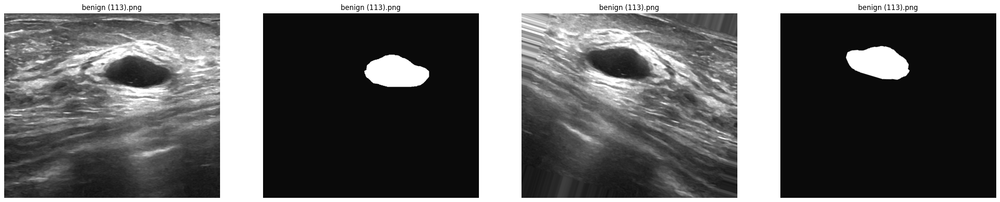

['benign']


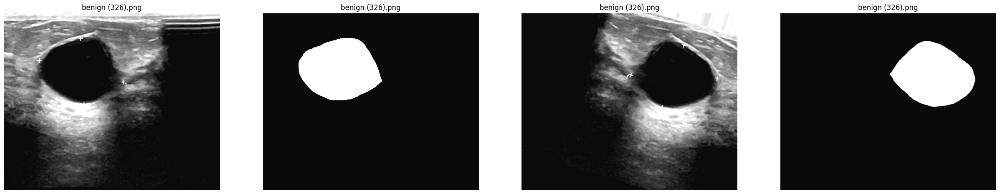

['malignant']


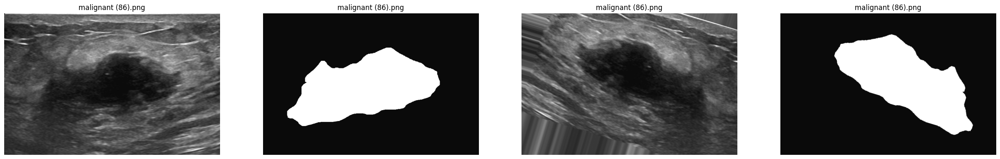

['malignant']


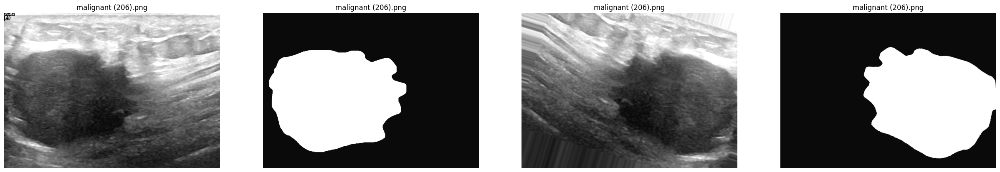

['normal']


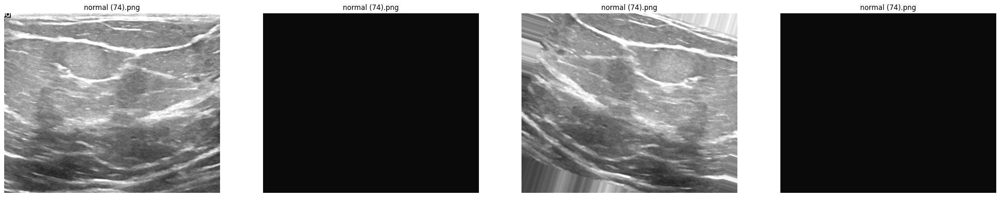

['normal']


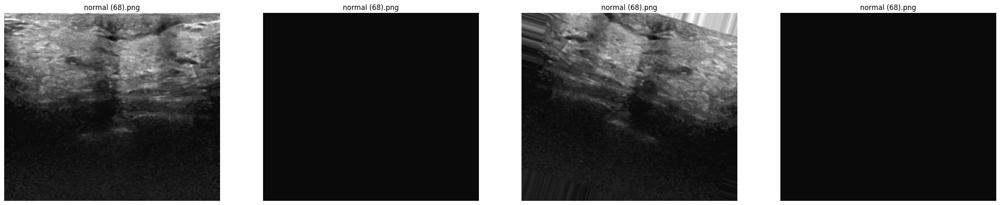

In [ ]:
# Preprocessing parameters
noise_reduction_kernel_size = 3
contrast_alpha = 1.2
contrast_beta = 10

data_augmentation = ImageDataGenerator(
    rotation_range=30,
    horizontal_flip=True,
    vertical_flip=True,
    # elastic_deformation=True
)

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Apply preprocessing
            img = cv2.medianBlur(img, noise_reduction_kernel_size)
            img = cv2.convertScaleAbs(img, alpha=contrast_alpha, beta=contrast_beta)
            msk = cv2.medianBlur(msk, noise_reduction_kernel_size)
            msk = cv2.convertScaleAbs(msk, alpha=contrast_alpha, beta=contrast_beta)

            # Apply data augmentation
            augmented_images = data_augmentation.flow(np.expand_dims(img, axis=0),
                                                      batch_size=1,
                                                      seed=13)
            augmented_image = next(augmented_images)[0].astype(np.uint8)
            augmented_msks = data_augmentation.flow(np.expand_dims(msk, axis=0),
                                                    batch_size=1,
                                                    seed=13)
            augmented_msk = next(augmented_msks)[0].astype(np.uint8)

            plot4(img, msk, augmented_image, augmented_msk, image)

def plot4(img, msk, augmented_image, augmented_msk, title=None):
    fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img, msk, augmented_image, augmented_msk]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    #axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    #axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(benign_dir, 2)
malignant_images = select_random_images(malignant_dir, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)


In [ ]:
data_gen_args = dict(rotation_range=45.,
                     width_shift_range=0.1,
                     height_shift_range=0.1,
                     shear_range=0.2,
                     zoom_range=0.2,
                     horizontal_flip=True,
                     vertical_flip=True,
                     fill_mode='reflect')

In [ ]:
# Preprocessing parameters
noise_reduction_kernel_size = 3
contrast_alpha = 1.2
contrast_beta = 10

load_train_data()


data_augmentation = ImageDataGenerator(
    rotation_range=30,
    horizontal_flip=True,
    vertical_flip=True,
    # elastic_deformation=True
)

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Apply preprocessing
            img = cv2.medianBlur(img, noise_reduction_kernel_size)
            img = cv2.convertScaleAbs(img, alpha=contrast_alpha, beta=contrast_beta)
            msk = cv2.medianBlur(msk, noise_reduction_kernel_size)
            msk = cv2.convertScaleAbs(msk, alpha=contrast_alpha, beta=contrast_beta)

            # Apply data augmentation
            augmented_images = data_augmentation.flow(np.expand_dims(img, axis=0),
                                                      batch_size=1,
                                                      seed=13)
            augmented_image = next(augmented_images)[0].astype(np.uint8)
            augmented_msks = data_augmentation.flow(np.expand_dims(msk, axis=0),
                                                    batch_size=1,
                                                    seed=13)
            augmented_msk = next(augmented_msks)[0].astype(np.uint8)

            plot4(img, msk, augmented_image, augmented_msk, image)


In [ ]:
tf.keras.utils.image_dataset_from_directory(
    directory,
    labels='inferred',
    label_mode='int',
    class_names=None,
    color_mode='rgb',
    batch_size=32,
    image_size=(256, 256),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation='bilinear',
    follow_links=False,
    crop_to_aspect_ratio=False,
    **kwargs
)

In [ ]:
!pip install tensorflow[and-cuda]

INFO: pip is looking at multiple versions of tensorflow[and-cuda] to determine which version is compatible with other requirements. This could take a while.
  Using cached nvidia_cublas_cu11-11.11.3.6-py3-none-win_amd64.whl (427.2 MB)
  Using cached nvidia_cuda_cupti_cu11-11.8.87-py3-none-win_amd64.whl (10.0 MB)
  Using cached nvidia_cuda_nvcc_cu11-11.8.89-py3-none-win_amd64.whl (15.7 MB)
  Using cached nvidia_cuda_runtime_cu11-11.8.89-py3-none-win_amd64.whl (1.0 MB)
  Using cached absl_py-2.0.0-py3-none-any.whl.metadata (2.3 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl (12 kB)
  Using cached flatbuffers-23.5.26-py2.py3-none-any.whl.metadata (850 bytes)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl (57 kB)
  Using cached libclang-16.0.6-py2.py3-none-win_amd64.whl.metadata (5.3 kB)
     ---------------------------------------- 0.0/14.9 MB ? eta -:--:--
     ---------------------------------------- 0.1/14.9 MB 2.6 MB/s 

  You can safely remove it manually.
  You can safely remove it manually.


In [ ]:

sorted(glob.glob(config.DATA_DIR+'*/*'))

['../data/raw/Dataset_BUSI_with_GT\\benign\\benign (1).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (1)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (10).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (10)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100)_mask_1.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (101).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (101)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (102).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (102)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (103).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (103)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (104).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (104)_mask.png',
 '../data/raw/Datas

In [ ]:
benign = 'benign'
maligant = 'maligant'
normal = 'normal'
[i for i in [benign,normal,maligant] if all([i in [benign,normal,maligant], i in benign])]

['benign']

In [ ]:
benign_images[0]

['benign (184).png', 'benign (324).png']

In [ ]:
img.shape

(469, 562, 3)

In [ ]:
    # Convert the mask to a binary image
    msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
    ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)

    # Create a transparent mask using alpha channel
    alpha_channel = msk_binary.astype(float) / 255.0
    img_with_mask = img.copy()
    img_with_mask[:, :, 3] = alpha_channel

    # Plot the original image and the image with overlaid mask
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Original Image')

    axs[1].imshow(cv2.cvtColor(img_with_mask, cv2.COLOR_BGRA2RGBA))
    axs[1].set_title('Image with Mask Overlay')